In [1]:
import scanpy as sc
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
datadir = '/oak/stanford/groups/pritch/users/emma/data/TcellsGW_pilot/processed_data/'
adata = sc.read_h5ad(datadir + 'TcellsGW_pilot_merged.gex.lognorm.h5ad', backed=True)

In [ ]:
adata.obs.drop(['batch'], axis=1, inplace=True)
adata.var = adata.var[['gene_ids', 'gene_name','highly_variable', 'means', 'dispersions', 'dispersions_norm']].copy()

HYBRID_PARAMS = [
    "half_million",
    "three_quarter_million",
    "one_million",
    "one_and_half_million"
]
adata.obs['hybridization_condition'] = adata.obs['hybridization_condition'].astype('category').cat.reorder_categories(HYBRID_PARAMS)

TIMEPOINTS = ["Day7", "Rest", "Restim_6hr", "Restim_24hr"]
adata.obs['timepoint'] = adata.obs['timepoint'].astype('category').cat.reorder_categories(TIMEPOINTS)

# reorder sample_id by hybridization_condition
adata.obs['sample_id'] = adata.obs['sample_id'].astype('category').cat.reorder_categories(adata.obs.sort_values(['hybridization_condition', 'timepoint'])['sample_id'].astype(str).unique())


In [3]:
adata.obs

,hybridization_condition,timepoint,sample_id,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,total_counts_mt,log1p_total_counts_mt,pct_counts_mt,n_genes,low_quality
AAACAAGCACAACAATATCATGTG-1_Restim_24hr_three_quarter_million,three_quarter_million,Restim_24hr,Restim_24hr_three_quarter_million,5737,8.654866,19568.0,9.881702,14.886549,19.853843,26.584219,39.595258,24.0,3.218876,0.122649,5737,False
AAACAAGCAGCCTGAGATCATGTG-1_Restim_24hr_three_quarter_million,three_quarter_million,Restim_24hr,Restim_24hr_three_quarter_million,4630,8.440528,12508.0,9.434204,15.214263,20.706748,27.766230,41.549408,59.0,4.094345,0.471698,4630,False
AAACAAGCATACTTCAATCATGTG-1_Restim_24hr_three_quarter_million,three_quarter_million,Restim_24hr,Restim_24hr_three_quarter_million,5676,8.644178,15537.0,9.651044,12.132329,16.470361,22.468945,35.277081,75.0,4.330733,0.482719,5676,False
AAACCAATCACAAAGCATCATGTG-1_Restim_24hr_three_quarter_million,three_quarter_million,Restim_24hr,Restim_24hr_three_quarter_million,5973,8.695172,25345.0,10.140376,14.969422,19.739594,26.450977,39.408167,254.0,5.541264,1.002170,5973,False
AAACCAATCACTATGTATCATGTG-1_Restim_24hr_three_quarter_million,three_quarter_million,Restim_24hr,Restim_24hr_three_quarter_million,3540,8.172164,6794.0,8.823942,11.745658,16.794230,23.741537,38.857816,23.0,3.178054,0.338534,3540,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTGAGTGCGTACCATGTTGAC-1_Day7_one_and_half_million,one_and_half_million,Day7,Day7_one_and_half_million,5919,8.686092,24597.0,10.110420,13.863479,18.571370,25.364882,38.951905,103.0,4.644391,0.418750,5919,False
TTTGTGAGTGCTGATTATGTTGAC-1_Day7_one_and_half_million,one_and_half_million,Day7,Day7_one_and_half_million,4879,8.492900,12110.0,9.401870,14.624277,19.025599,25.441784,38.455822,799.0,6.684612,6.597853,4879,True
TTTGTGAGTGGAAGCTATGTTGAC-1_Day7_one_and_half_million,one_and_half_million,Day7,Day7_one_and_half_million,5997,8.699181,23850.0,10.079581,13.136268,17.781971,24.574423,38.138365,138.0,4.934474,0.578616,5997,False
TTTGTGAGTGGCTTTGATGTTGAC-1_Day7_one_and_half_million,one_and_half_million,Day7,Day7_one_and_half_million,5180,8.552753,18362.0,9.818093,17.247577,22.813419,30.100207,44.036597,121.0,4.804021,0.658970,5180,False


/tmp/ipykernel_81907/2439597048.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  pl_df = pl_df.groupby(['hybridization_condition', 'timepoint', 'sample_id']).size().reset_index(name='count')


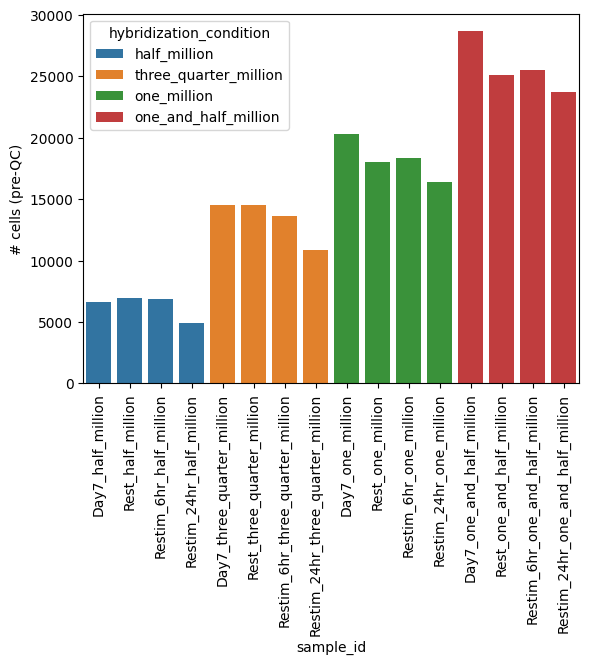

In [44]:
pl_df = sc.get.obs_df(adata, ['hybridization_condition', 'timepoint', 'sample_id'])
pl_df = pl_df.groupby(['hybridization_condition', 'timepoint', 'sample_id']).size().reset_index(name='count')
pl_df = pl_df[pl_df['count'] > 0].copy()

sns.barplot(data=pl_df, x='sample_id', y='count', hue='hybridization_condition');
plt.xticks(rotation=90);
plt.ylabel('# cells (pre-QC)');

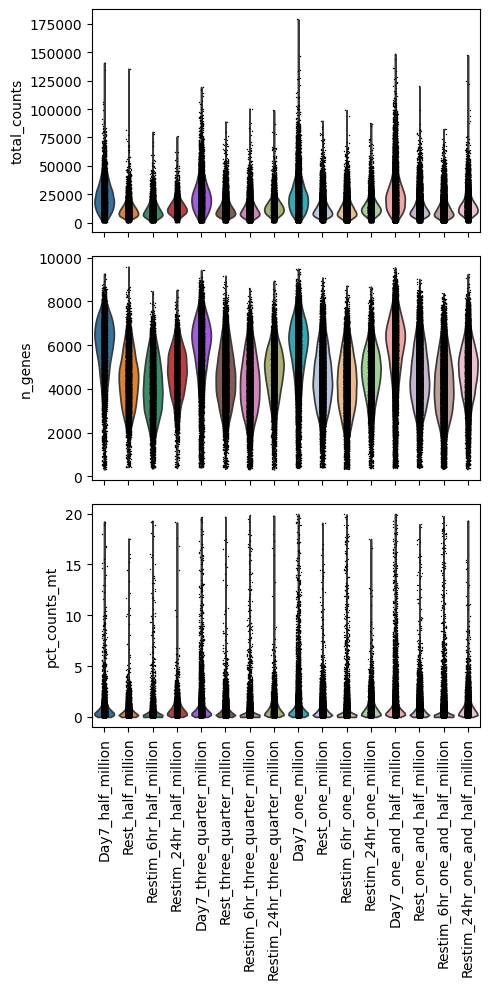

In [159]:
fig, axs = plt.subplots(3,1, figsize=(5,10))
for i,m in enumerate(['total_counts', 'n_genes', 'pct_counts_mt']):
    sc.pl.violin(adata, m, groupby='sample_id', rotation=90, show=False, ax=axs[i]);
    if i != 2:
        # remove x-axis tick labels
        axs[i].set_xticklabels([])

fig.tight_layout()
fig.show()
# sc.pl.violin(adata, ['total_counts', 'n_genes', 'pct_counts_mt'], groupby='sample_id', rotation=90)
# order_samples = adata.obs.sort_values(['timepoint', 'hybridization_condition'])['sample_id'].astype(str).unique()
# sc.pl.violin(adata, ['total_counts', 'n_genes', 'pct_counts_mt'], groupby='sample_id', rotation=90, order=order_samples)

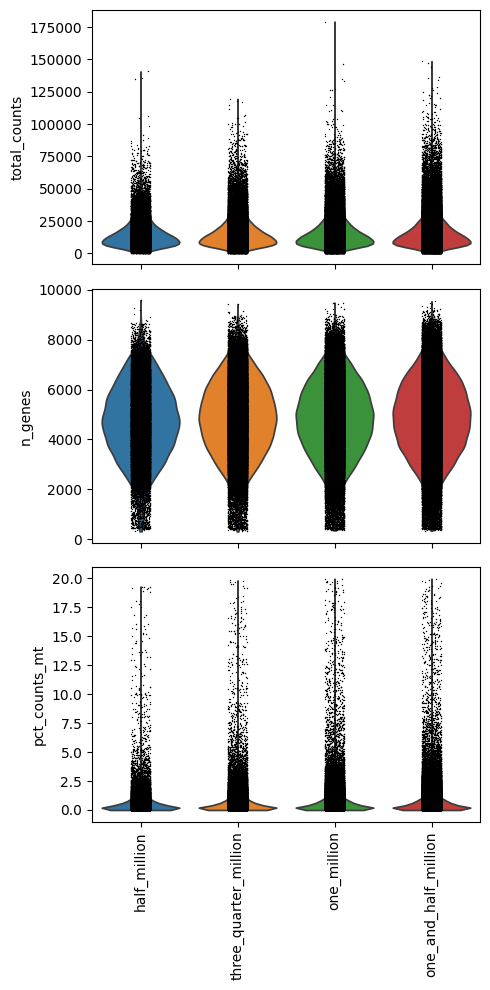

In [142]:
fig, axs = plt.subplots(3,1, figsize=(5,10))
for i,m in enumerate(['total_counts', 'n_genes', 'pct_counts_mt']):
    sc.pl.violin(adata, m, groupby='hybridization_condition', rotation=90, show=False, ax=axs[i]);
    if i != 2:
        # remove x-axis tick labels
        axs[i].set_xticklabels([])

fig.tight_layout()
fig.show()

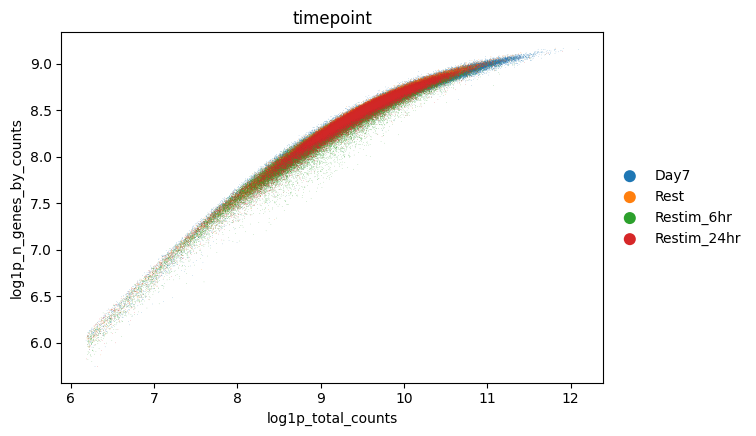

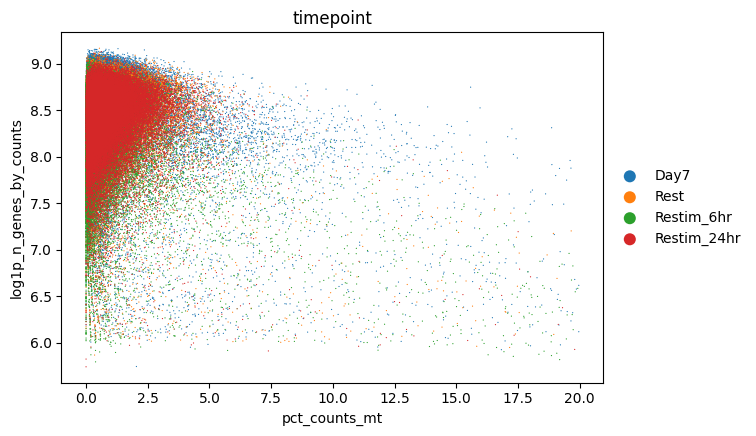

In [85]:
sc.pl.scatter(adata, 'log1p_total_counts', 'log1p_n_genes_by_counts', color='timepoint')
sc.pl.scatter(adata, 'pct_counts_mt', 'log1p_n_genes_by_counts', color='timepoint', size=3)

In [158]:
# pd.concat([adata.obs['sample_id'], adata.obs['pct_counts_mt'] > 5], axis=1).groupby('sample_id').sum()
adata.obs[['total_counts', 'n_genes', 'pct_counts_mt', 'sample_id']].groupby('sample_id').mean()

/tmp/ipykernel_81907/536542618.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata.obs[['total_counts', 'n_genes', 'pct_counts_mt', 'sample_id']].groupby('sample_id').mean()


,total_counts,n_genes,pct_counts_mt
sample_id,,,
Day7_half_million,24127.240234,5760.353413,0.845344
Rest_half_million,12746.656250,4425.286476,0.579526
Restim_6hr_half_million,12026.542969,4040.071210,0.487201
Restim_24hr_half_million,14191.484375,4690.263770,0.863888
Day7_three_quarter_million,24399.544922,5757.962403,0.854601
Rest_three_quarter_million,13564.589844,4545.077574,0.607347
Restim_6hr_three_quarter_million,12805.018555,4179.620379,0.457634
Restim_24hr_three_quarter_million,14550.731445,4722.645727,0.848362
Day7_one_million,23995.167969,5707.520149,0.924295


In [90]:
adata.obs['low_quality'] = (adata.obs['pct_counts_mt'] > 5) | (adata.obs['n_genes'] < 1000)

/tmp/ipykernel_81907/578711439.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  low_quality_df = adata.obs.groupby(['sample_id', 'hybridization_condition'])['low_quality'].mean().reset_index(name='fraction_low_quality')


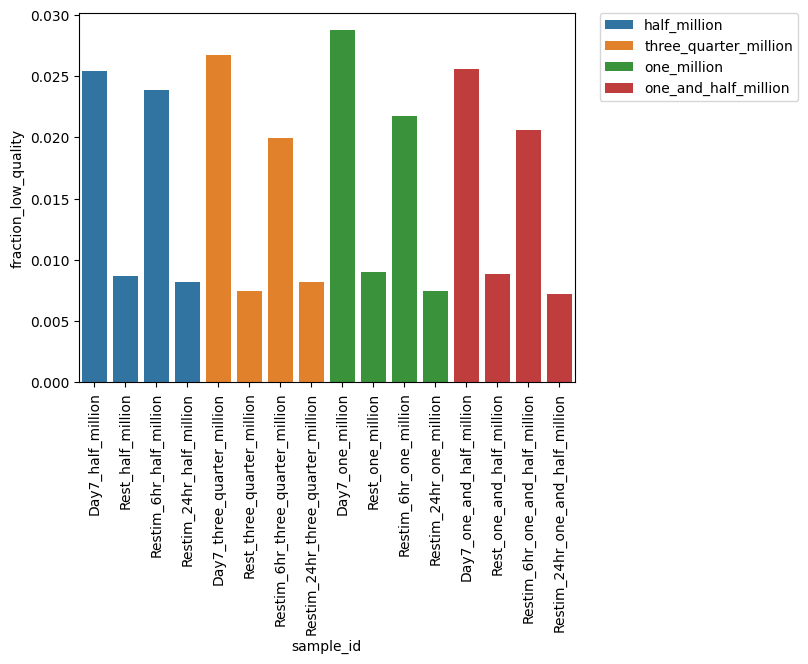

In [132]:
# plot fraction of low_quality cells for each sample_id
low_quality_df = adata.obs.groupby(['sample_id', 'hybridization_condition'])['low_quality'].mean().reset_index(name='fraction_low_quality')
low_quality_df
sns.barplot(data=low_quality_df, x='sample_id', y='fraction_low_quality', hue='hybridization_condition', dodge=False);
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.);
plt.xticks(rotation=90);


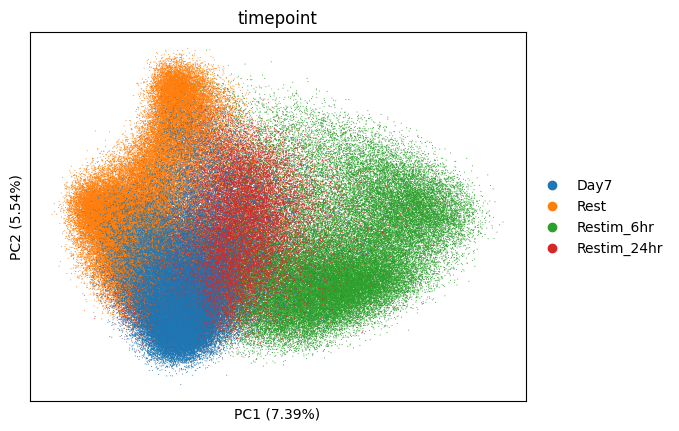

In [161]:
sc.pl.pca(adata, annotate_var_explained=True, color=['timepoint'], components=['1,2'], wspace=0.5, ncols=3, size=2)

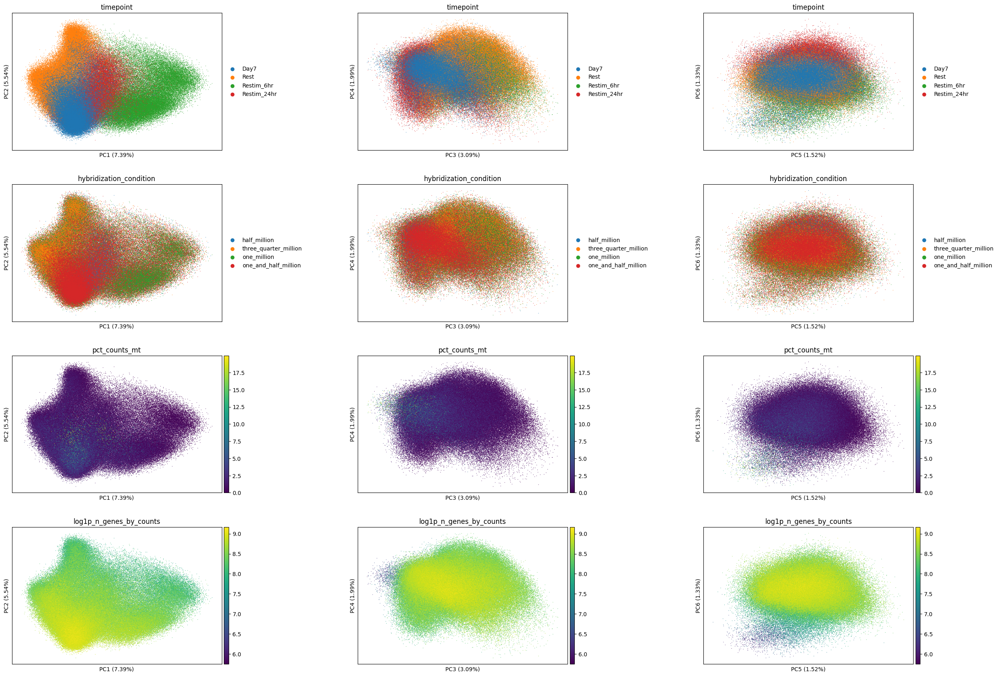

In [83]:

sc.pl.pca(adata, annotate_var_explained=True, color=['timepoint', 'hybridization_condition', 'pct_counts_mt', 'log1p_n_genes_by_counts'], components=['1,2', '3,4', '5,6'], wspace=0.5, ncols=3, size=3)

In [69]:
any(adata.var['gene_name'] == 'MALAT1')

False

In [72]:
adata.var_names = adata.var['gene_name'].values

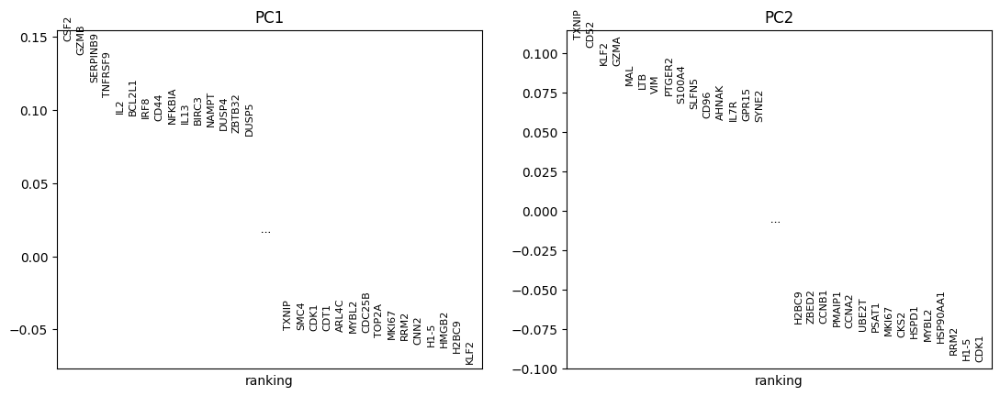

In [163]:
sc.pl.pca_loadings(adata, components='1,2');

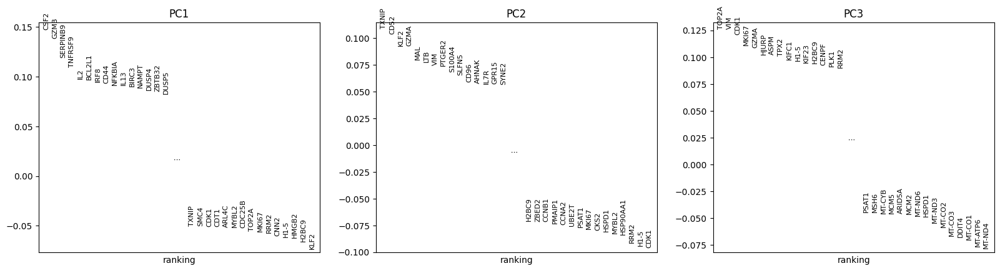

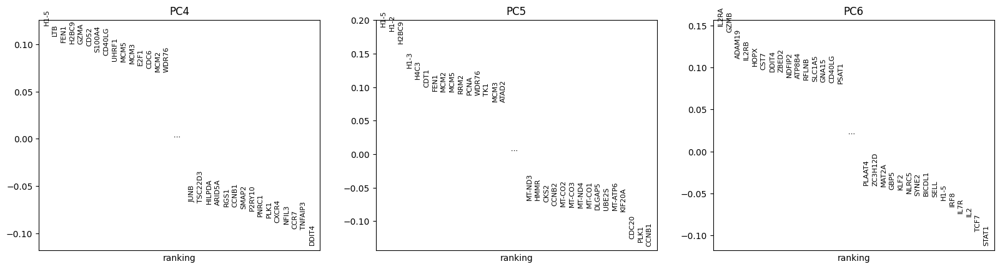

In [81]:
sc.pl.pca_loadings(adata, components='1,2,3');
sc.pl.pca_loadings(adata, components='4,5,6')

## Clustering

In [103]:
sc.pp.neighbors(adata, n_neighbors=50)

In [104]:
sc.tl.umap(adata)

In [126]:
adata.write_h5ad()

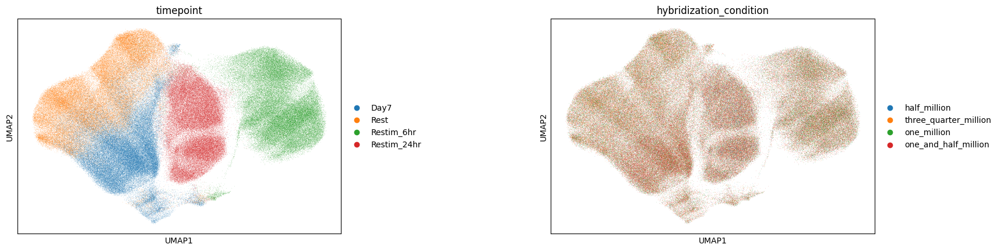

In [106]:
sc.pl.umap(adata, color=['timepoint', 'hybridization_condition'], wspace=0.5)

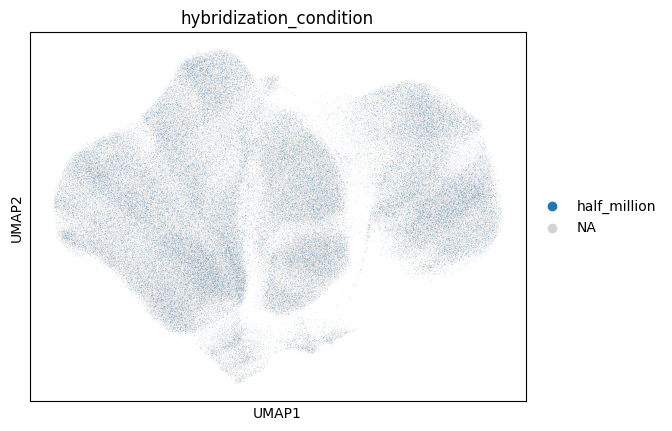

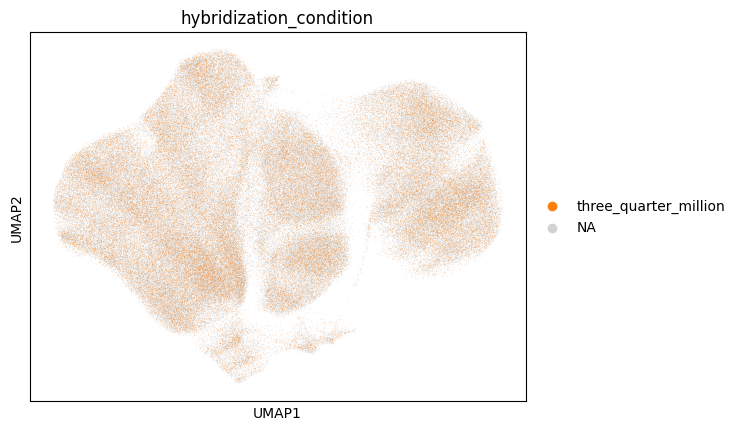

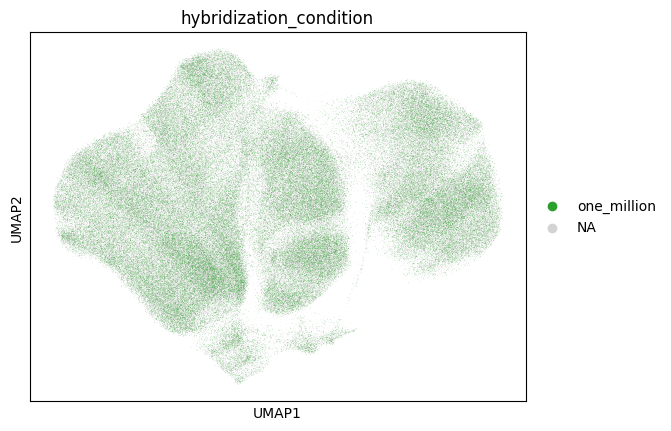

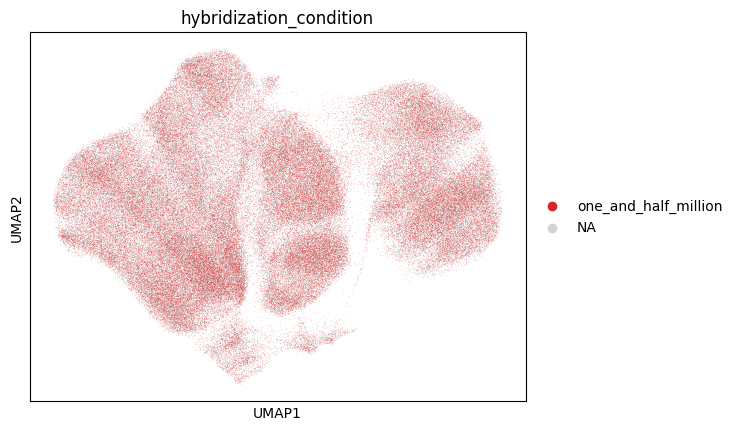

In [110]:
for g in HYBRID_PARAMS:
    sc.pl.umap(adata, color=['hybridization_condition'], groups=[g], wspace=0.5)

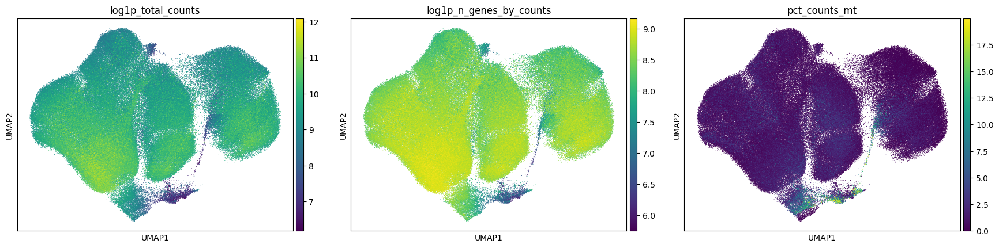

In [147]:
sc.pl.umap(adata, color=['log1p_total_counts','log1p_n_genes_by_counts','pct_counts_mt'], wspace=0.1, size=3, ncols=3)

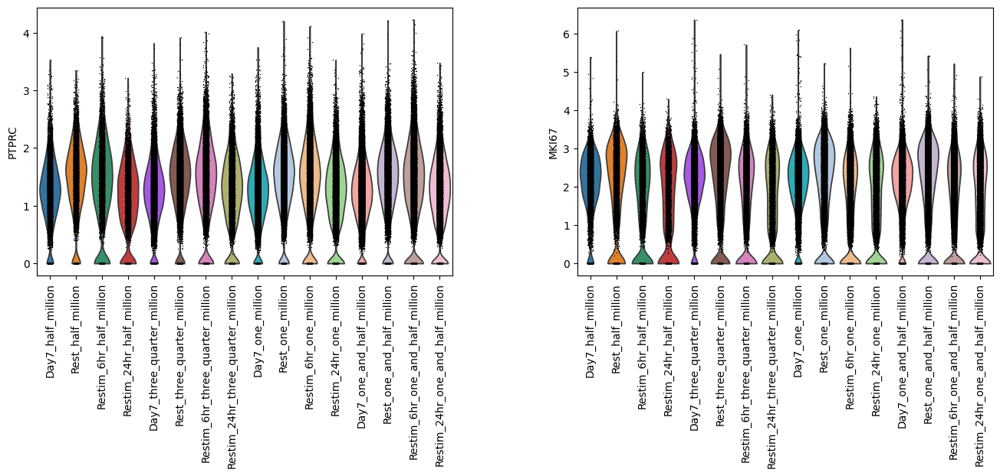

In [115]:
sc.pl.violin(adata, ['PTPRC', 'MKI67'], groupby='sample_id', rotation=90)

In [177]:
pl_df = sc.get.obs_df(adata, ['CD3D','CD4', 'pct_counts_mt'])

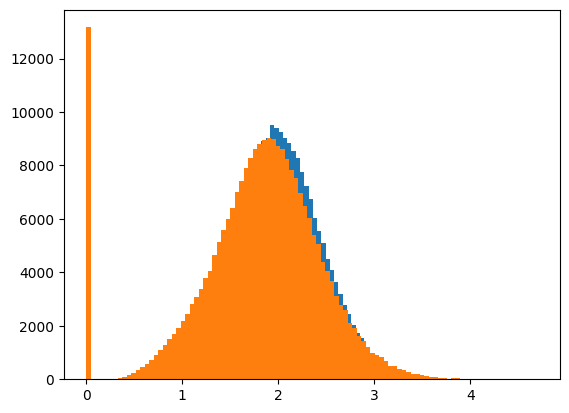

In [178]:
plt.hist(pl_df.sort_values("CD3D")['CD3D'], bins=100);
plt.hist(pl_df['CD4'], bins=100);

<Axes: xlabel='no_CD3', ylabel='pct_counts_mt'>

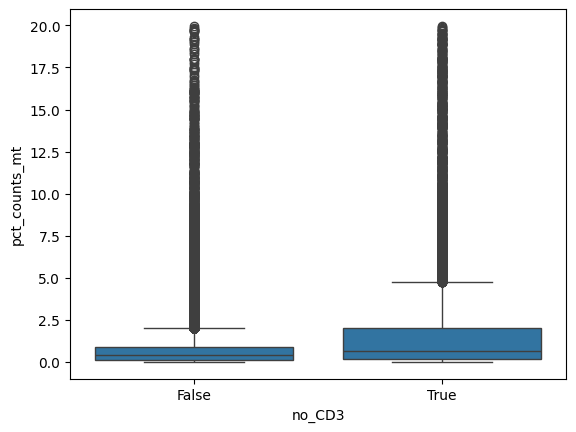

In [174]:
pl_df['no_CD3'] = pl_df['CD3D']== 0
sns.boxplot(pl_df, x='no_CD3', y='pct_counts_mt')

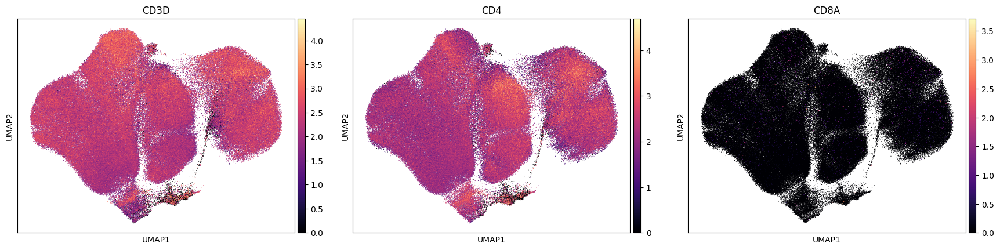

In [168]:
sc.pl.umap(adata, color=['CD3D', 'CD4', 'CD8A'], wspace=0.1, size=3, cmap='magma', ncols=3)

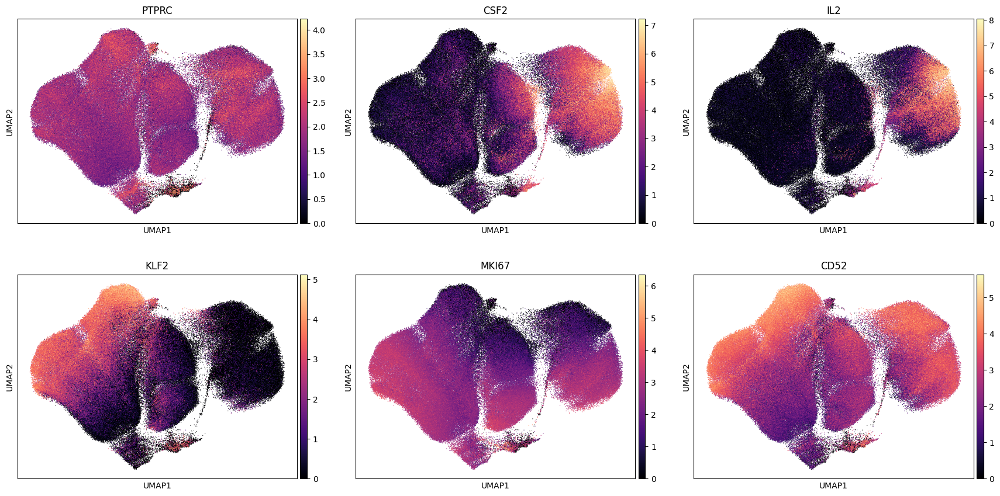

In [181]:
sc.pl.umap(adata, color=['PTPRC', 'CSF2', 'IL2', 'KLF2', 'MKI67', 'CD52'], wspace=0.1, size=3, cmap='magma', ncols=3)

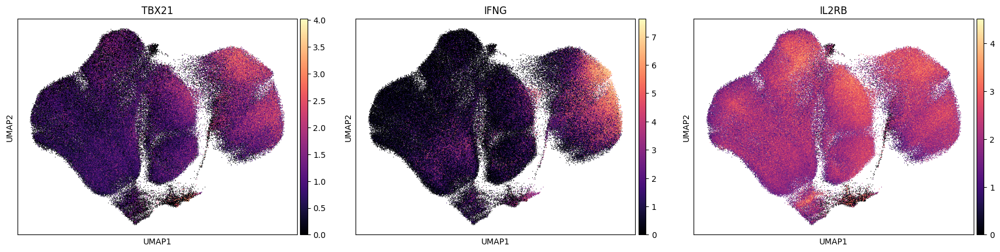

In [182]:
sc.pl.umap(adata, color=['TBX21', 'IFNG', 'IL2RB'], wspace=0.1, size=3, cmap='magma', ncols=3)

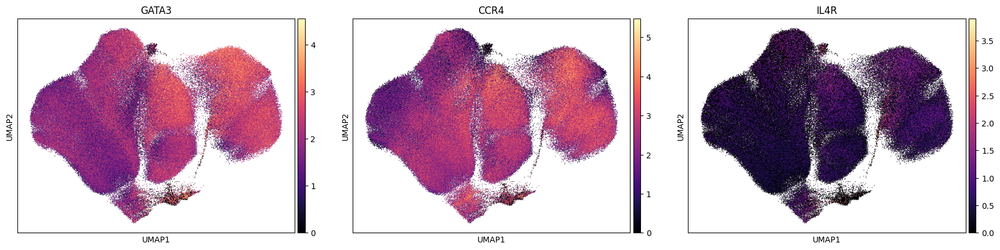

In [183]:
sc.pl.umap(adata, color=['GATA3', 'CCR4', 'IL4R'], wspace=0.1, size=3, cmap='magma', ncols=3)

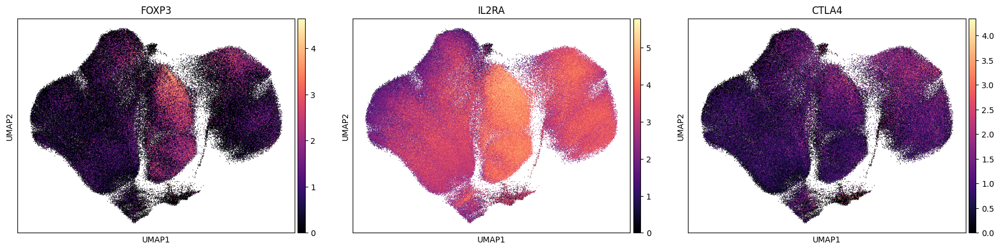

In [184]:
sc.pl.umap(adata, color=['FOXP3', 'IL2RA', 'CTLA4'], wspace=0.1, size=3, cmap='magma', ncols=3)

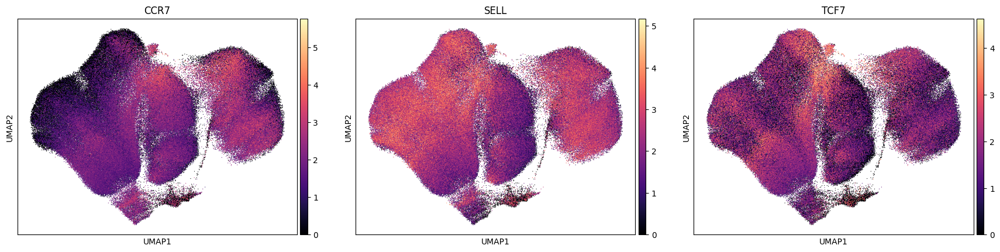

In [185]:
sc.pl.umap(adata, color=['CCR7', 'SELL', 'TCF7'], wspace=0.1, size=3, cmap='magma', ncols=3)

In [199]:
## Read T cell markers table
Tcell_markers = pd.read_csv('https://docs.google.com/spreadsheets/d/1NSjrMofwd7etOJVvqHXFMNV0--gjzg8BzHMWGxK7SUI/export?format=csv')
Tcell_markers = Tcell_markers[Tcell_markers['gene_name'].isin(adata.var['gene_name'])]
Tcell_markers['state_program_name'] = Tcell_markers['state_program_name'].astype('category').cat.reorder_categories(Tcell_markers.state_program_name.unique())
markers_dict = Tcell_markers.groupby('state_program_name')['gene_name'].apply(list).to_dict()
markers_dict

/tmp/ipykernel_81907/1238051305.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  markers_dict = Tcell_markers.groupby('state_program_name')['gene_name'].apply(list).to_dict()


{'general': ['CD3D', 'CD4', 'CD8A'],
 'Naive': ['CCR7', 'SELL', 'LEF1', 'TCF7'],
 'Cytotoxic': ['NKG7', 'PRF1', 'GZMB'],
 'Treg': ['FOXP3', 'IL2RA', 'CTLA4', 'TNFRSF18'],
 'Innate like': ['ZBTB16', 'KLRB1'],
 'Th1': ['TBX21', 'IFNG', 'IL2RB'],
 'Th2': ['GATA3', 'CCR4', 'IL4R'],
 'Th17': ['CCR6', 'IL23R', 'PTGER2'],
 'Cycling': ['MKI67', 'PCNA', 'MCM7'],
 'ISG': ['ISG15', 'MX1', 'IFI44']}

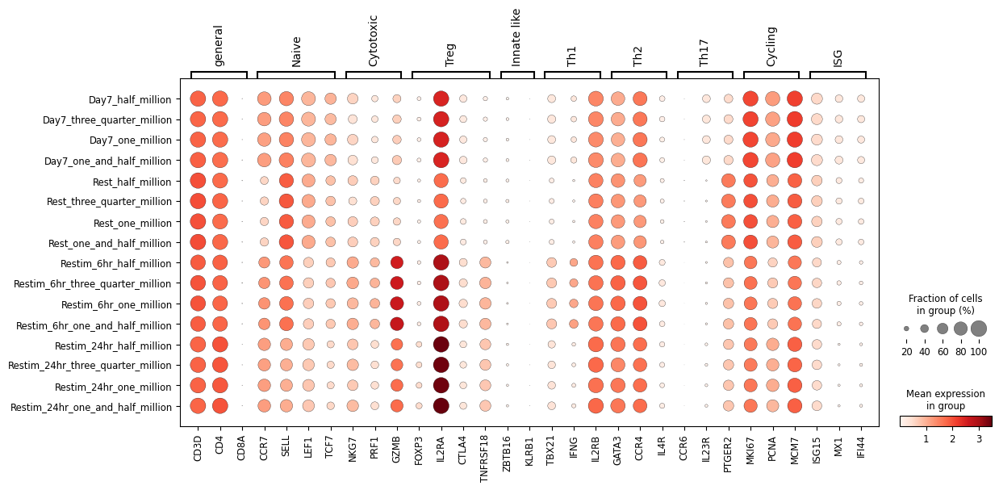

In [200]:
order_samples = adata.obs.sort_values(['timepoint', 'hybridization_condition'])['sample_id'].astype(str).unique()
adata.obs['sample_id'] = adata.obs['sample_id'].cat.reorder_categories(order_samples)
sc.pl.dotplot(adata, markers_dict, groupby='sample_id')

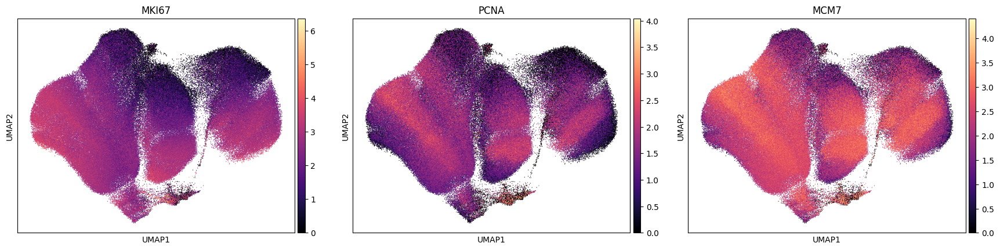

In [202]:
sc.pl.umap(adata, color=markers_dict['Cycling'], wspace=0.1, size=3, cmap='magma', ncols=3)

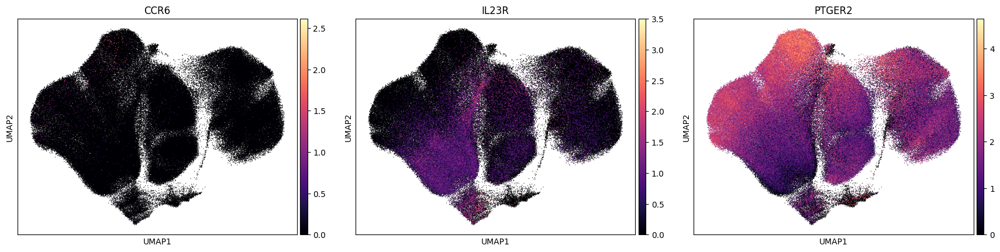

In [203]:
sc.pl.umap(adata, color=markers_dict['Th17'], wspace=0.1, size=3, cmap='magma', ncols=3)

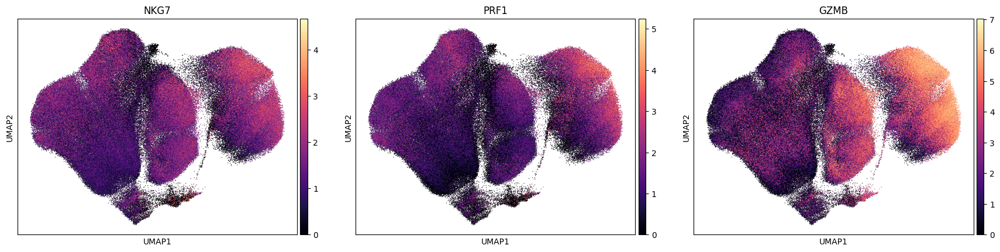

In [204]:
sc.pl.umap(adata, color=markers_dict['Cytotoxic'], wspace=0.1, size=3, cmap='magma', ncols=3)

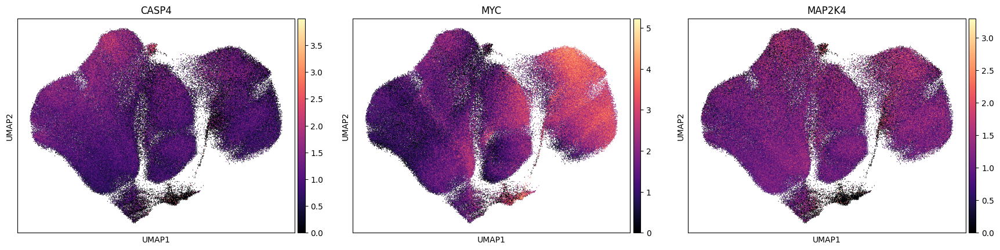

In [206]:
sc.pl.umap(adata, color=['CASP4', 'MYC', 'MAP2K4'], wspace=0.1, size=3, cmap='magma', ncols=3)

### Variance in effector marker expression

In [8]:
sc.pp.normalize_total(adata)
sc.pp.log1p(adata)

In [29]:
pl_df = sc.get.obs_df(adata, keys=['IFNG', 'TNF', 'timepoint', 'sample_id'])
pl_df

,IFNG,TNF,timepoint,sample_id
AAACAAGCACAACAATATCATGTG-1_Restim_24hr_three_quarter_million,0.000000,0.527147,Restim_24hr,Restim_24hr_three_quarter_million
AAACAAGCAGCCTGAGATCATGTG-1_Restim_24hr_three_quarter_million,0.000000,1.154277,Restim_24hr,Restim_24hr_three_quarter_million
AAACAAGCATACTTCAATCATGTG-1_Restim_24hr_three_quarter_million,0.000000,0.000000,Restim_24hr,Restim_24hr_three_quarter_million
AAACCAATCACAAAGCATCATGTG-1_Restim_24hr_three_quarter_million,0.728403,0.000000,Restim_24hr,Restim_24hr_three_quarter_million
AAACCAATCACTATGTATCATGTG-1_Restim_24hr_three_quarter_million,1.098318,0.000000,Restim_24hr,Restim_24hr_three_quarter_million
...,...,...,...,...
TTTGTGAGTGCGTACCATGTTGAC-1_Day7_one_and_half_million,0.000000,0.000000,Day7,Day7_one_and_half_million
TTTGTGAGTGCTGATTATGTTGAC-1_Day7_one_and_half_million,0.752148,0.000000,Day7,Day7_one_and_half_million
TTTGTGAGTGGAAGCTATGTTGAC-1_Day7_one_and_half_million,0.000000,0.450742,Day7,Day7_one_and_half_million
TTTGTGAGTGGCTTTGATGTTGAC-1_Day7_one_and_half_million,0.000000,0.000000,Day7,Day7_one_and_half_million


In [35]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

def plot_gene_ecdf(adata, gene, sample_col='sample_id', timepoint_col='timepoint', 
                   figsize=(10, 6), title=None, palette=None):
    """
    Plot empirical cumulative distribution of gene expression for each sample,
    colored by timepoint.
    
    Parameters:
    -----------
    df : pandas.DataFrame
        DataFrame containing gene expression data
    gene : str
        Name of the gene column containing expression values
    sample_col : str
        Name of the column containing sample IDs
    timepoint_col : str
        Name of the column containing timepoint assignments
    figsize : tuple
        Figure size (width, height)
    title : str, optional
        Plot title
    palette : dict or None
        Color mapping for timepoints. If None, uses default seaborn colors
        
    Returns:
    --------
    fig, ax : matplotlib figure and axis objects
    """
    df = sc.get.obs_df(adata, keys=[gene, 'timepoint', 'sample_id'])

    # Create figure
    fig, ax = plt.subplots(figsize=figsize)
    
    # Get unique timepoints for color mapping
    timepoints = df[timepoint_col].unique()
    if palette is None:
        palette = sns.color_palette("husl", n_colors=len(timepoints))
        palette = dict(zip(timepoints, palette))
    
    # Plot ECDF for each sample
    for sample in df[sample_col].unique():
        # Get sample data
        sample_data = df[df[sample_col] == sample]
        timepoint = sample_data[timepoint_col].iloc[0]
        
        # Calculate ECDF
        x = np.sort(sample_data[gene])
        y = np.arange(1, len(x) + 1) / len(x)
        
        # Plot line with appropriate color for timepoint
        ax.plot(x, y, color=palette[timepoint], alpha=0.5, 
                label=timepoint if timepoint not in ax.get_legend_handles_labels()[1] else "")
    
    # Customize plot
    if title is None:
        title = f'ECDF of {gene} Expression by Sample'
    ax.set_title(title)
    ax.set_xlabel(f'{gene} Expression (log-normalized)')
    ax.set_ylabel('Cumulative Fraction')
    
    # Add legend without duplicate entries
    handles, labels = ax.get_legend_handles_labels()
    by_label = dict(zip(labels, handles))
    ax.legend(by_label.values(), by_label.keys(), title='Timepoint')
    
    # Grid and spines
    ax.grid(True, alpha=0.3)
    sns.despine()
    
    return fig, ax

# Example usage:
# fig, ax = plot_gene_ecdf(pl_df, 'IFNG')
# plt.show()

# Custom color example:
# custom_colors = {
#     'Day7': '#ff7f0e',
#     'Rest': '#1f77b4',
#     'Restim_6hr': '#2ca02c',
#     'Restim_24hr': '#d62728'
# }
# fig, ax = plot_gene_ecdf(pl_df, 'IFNG', palette=custom_colors)

# plt.show()

(<Figure size 1000x600 with 1 Axes>,
 <Axes: title={'center': 'ECDF of CCL3 Expression by Sample'}, xlabel='CCL3 Expression (log-normalized)', ylabel='Cumulative Fraction'>)

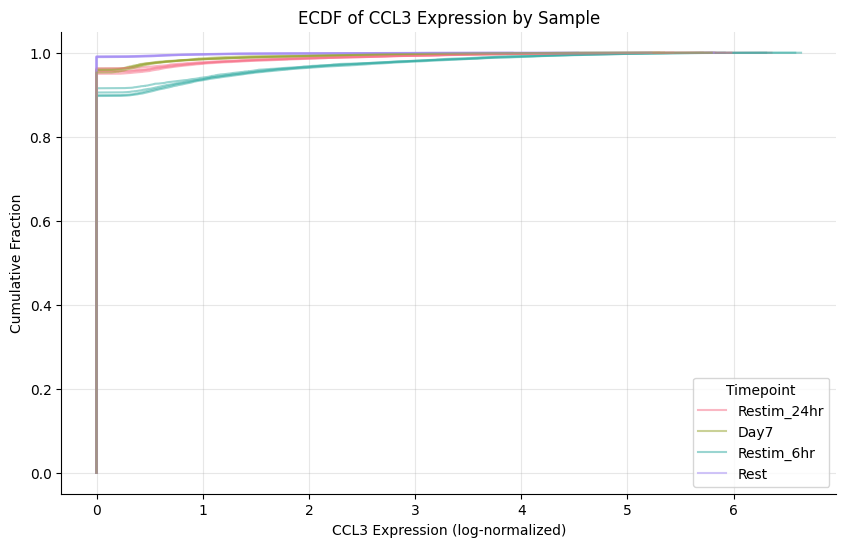

In [41]:
plot_gene_ecdf(adata, 'CCL3')

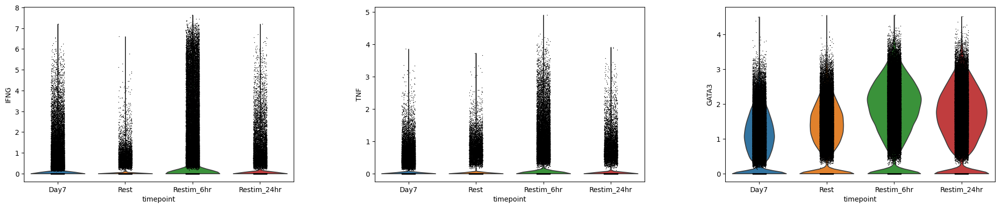

In [38]:
sc.pl.violin(adata, groupby='timepoint', keys=['IFNG', 'TNF', 'GATA3'])

In [14]:
pl_df = sc.get.obs_df(adata, ['IFNG', 'timepoint', 'sample_id'])
mean_pl_df = pl_df.groupby(['timepoint', 'sample_id']).mean().reset_index().dropna()
var_pl_df = pl_df.groupby(['timepoint', 'sample_id']).var().reset_index().dropna()

# join
mean_pl_df = mean_pl_df.merge(var_pl_df, on=['timepoint', 'sample_id'], suffixes=('_mean', '_var'))

/tmp/ipykernel_134469/4292481188.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_pl_df = pl_df.groupby(['timepoint', 'sample_id']).mean().reset_index().dropna()
/tmp/ipykernel_134469/4292481188.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  var_pl_df = pl_df.groupby(['timepoint', 'sample_id']).var().reset_index().dropna()


<Axes: xlabel='timepoint', ylabel='IFNG_mean'>

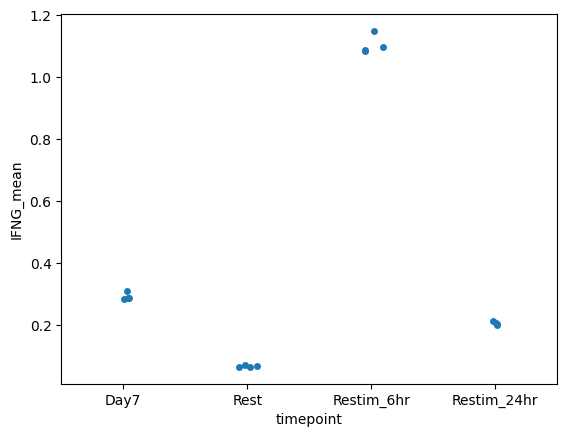

In [20]:
sns.stripplot(data=mean_pl_df, x='timepoint', y='IFNG_mean', dodge=True, jitter=True)

## Run PCA for each condition

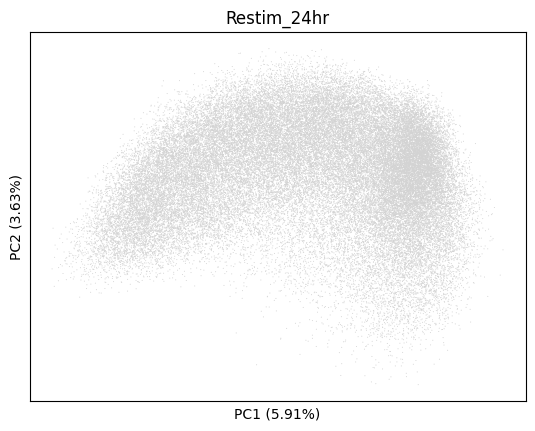

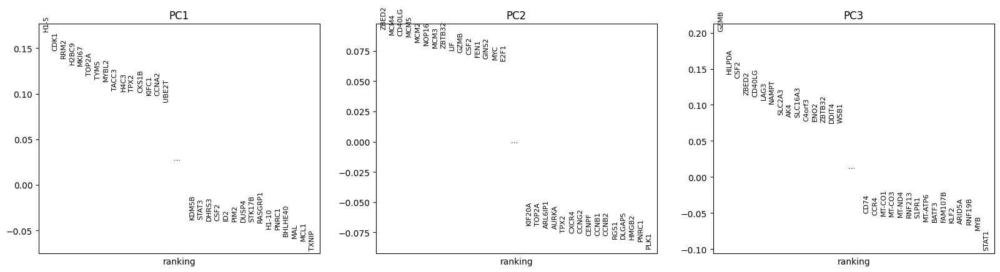

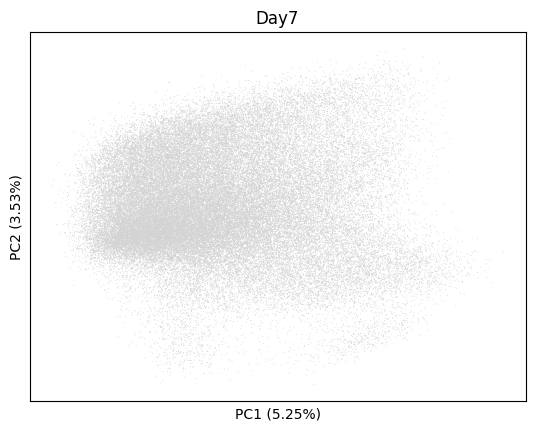

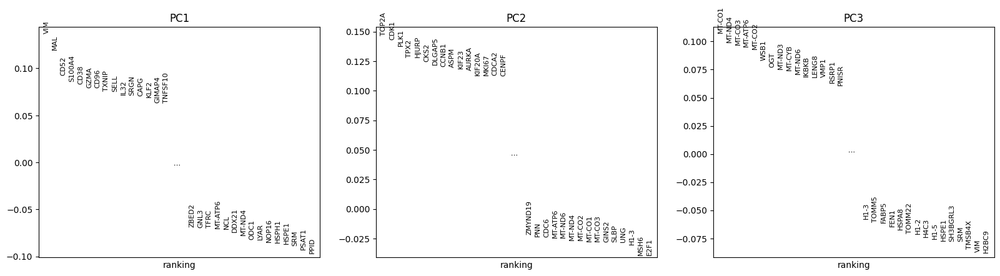

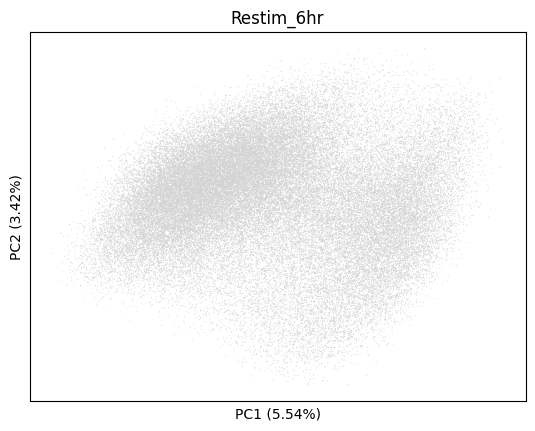

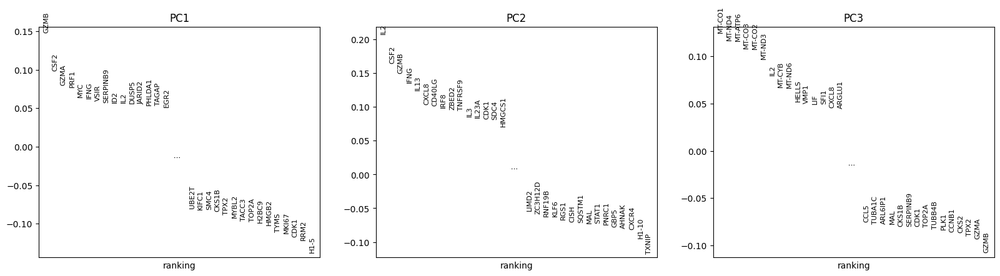

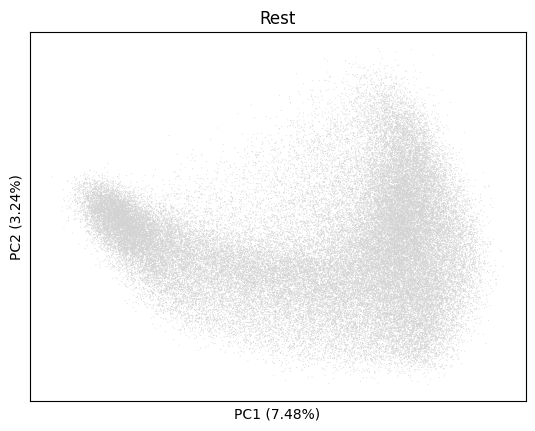

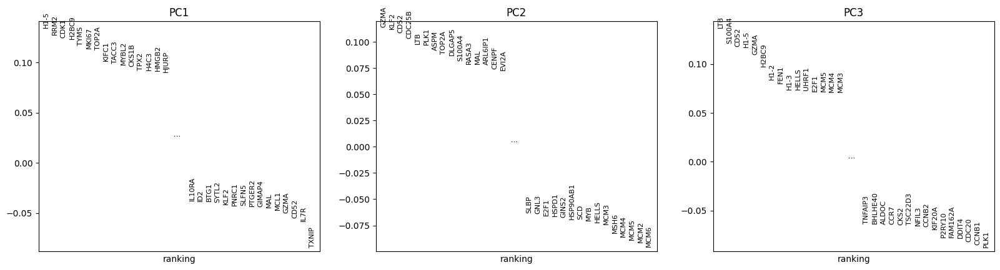

In [7]:
for c in adata.obs['timepoint'].unique():
    adata_c = adata[adata.obs['timepoint'] == c].to_memory()
    sc.pp.highly_variable_genes(adata_c, n_top_genes=5000)
    sc.pp.pca(adata_c, n_comps=20);
    sc.pl.pca(adata_c, components=['1,2'], annotate_var_explained=True, title=c)
    sc.pl.pca_loadings(adata_c)

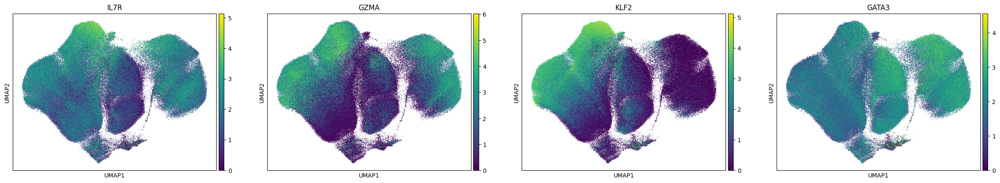

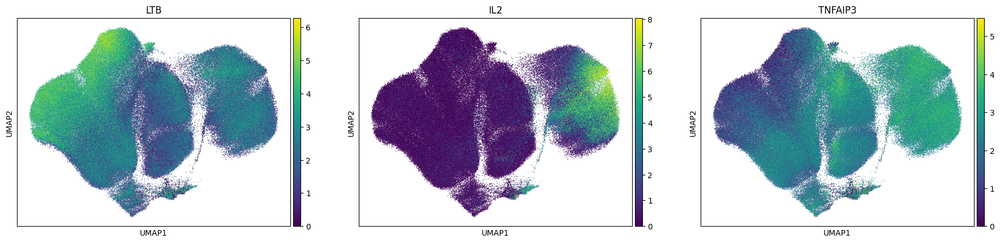

In [11]:
sc.pl.umap(adata, color=['IL7R', 'GZMA', 'KLF2', 'GATA3'], size=3, palette='magma');
sc.pl.umap(adata, color=['LTB', 'IL2', 'TNFAIP3'], size=3, palette='magma');

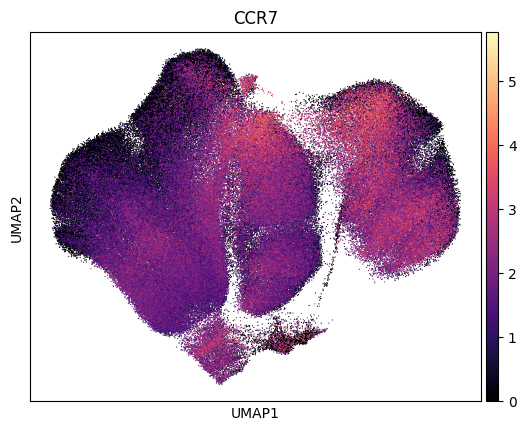

In [12]:
sc.pl.umap(adata, color=['CCR7'], size=3, cmap='magma');

## Test annotation with starCAT

In [4]:
adata = adata.to_memory()

In [5]:
import starcat

In [4]:
tcat = starcat.starCAT(reference='TCAT.V1', cachedir='../autoimmune_disease/cache')

Using reference from starCAT database
Loading reference from existing cache file for reference TCAT.V1


In [95]:
tcat.ref['PTPRC'].sort_values(ascending=False)

Poor-Quality           602.535522
CD8-EM                 352.033295
Doublet-Myeloid        336.867828
Tfh-1                  310.421692
Cytotoxic              264.422394
SOX4/TOX2              258.798370
Doublet-Plasmablast    255.944489
Tph                    249.593826
CD4-CM                 223.841919
Treg                   214.727722
gdT                    212.780807
Tfh-2                  210.481476
ICOS/CD38              200.302414
CD8-Trm                195.746399
CTLA4/CD38             192.480804
TEMRA                  191.692200
HLA                    190.203903
Doublet-Bcell          183.193253
Mito                   180.020187
CD40LG/TXNIP           176.800415
RGCC/MYADM             172.609375
ISG                    167.914764
Doublet-Platelet       167.192780
CellCycle-G2M          163.645065
IL10/IL19              154.323837
Exhaustion             148.612717
Th17-Activated         143.758286
Th1-Like               130.817520
Multi-Cytokine         129.680222
CD4-Naive     

In [45]:
tcat.ref.loc['Poor-Quality'].sort_values(ascending=False)[0:50]

SYNE2        653.108887
MACF1        607.707642
PTPRC        602.535522
HNRNPA2B1    541.958679
GOLGB1       539.646667
HNRNPU       539.532654
MYH9         538.549255
UTRN         502.958435
AHNAK        501.974976
RNF213       485.200348
GOLGA4       479.325745
NCL          475.790833
SYNE1        461.825775
SLFN5        459.302460
SMCHD1       449.912018
ITGA4        443.084351
VPS13C       427.291840
LCP1         423.710876
ATRX         419.182281
SPTBN1       412.062805
SFPQ         405.950714
SMC1A        398.779846
BPTF         392.394043
AKAP9        391.085938
AKAP13       388.965881
TPR          377.242554
EIF3A        373.103363
ANKRD12      367.975586
HNRNPA3      362.232208
GCC2         356.690735
KIAA1109     350.828705
BDP1         344.902161
ANKRD36C     343.517426
CEP350       343.399353
BOD1L1       340.758759
PRKDC        340.650085
ROCK1        335.564575
RIF1         330.210846
IQGAP1       323.911133
SPEN         323.726715
HNRNPD       318.082672
PARP14       318

In [8]:
if 'counts' in adata.layers:
    adata.X = adata.layers['counts'].copy()
usage, scores = tcat.fit_transform(adata)
# adata.obs = pd.concat([adata.obs, scores], axis=1)
# sc.pp.normalize_total(adata)
# sc.pp.log1p(adata)

3217 out of 3412 genes in the reference overlap with the query


/oak/stanford/groups/pritch/users/emma/miniforge3/envs/pertpy-milo/lib/python3.12/site-packages/starcat/starcat.py:253: UserWarning: WARNING!: query input has 3 genes with 0 counts after overlapping with query. Normalized values for these genes are set to 0.
  warnings.warn("""WARNING!: query input has %d genes with 0 counts after overlapping with query. Normalized values for these genes are set to 0.""" % num_zeros, UserWarning)
/home/users/emmadann/.local/lib/python3.12/site-packages/sklearn/base.py:376: InconsistentVersionWarning: Trying to unpickle estimator LogisticRegression from version 1.0.2 when using version 1.5.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


In [91]:
usage.drop('sample_id', axis=1).mean(axis=0).sort_values(ascending=False)

Poor-Quality           0.122424
CellCycle-S            0.052634
OX40/EBI3              0.045979
BCL2/FAM13A            0.041479
CD4-Naive              0.040661
NME1/FABP5             0.038633
Treg                   0.037174
Tph                    0.032985
CD8-Naive              0.032313
CD40LG/TXNIP           0.031631
Tfh-2                  0.029879
Exhaustion             0.027898
CellCycle-Late-S       0.024802
Th17-Resting           0.021535
IEG2                   0.020857
TEMRA                  0.020174
Th2-Resting            0.018211
Th22                   0.017520
Cytotoxic              0.016764
CellCycle-G2M          0.016709
Doublet-Plasmablast    0.016600
Multi-Cytokine         0.015920
ISG                    0.015461
MAIT                   0.015009
IL10/IL19              0.014539
CD8-Trm                0.014533
Th2-Activated          0.014155
Th1-Like               0.013987
HLA                    0.013602
CTLA4/CD38             0.013070
ICOS/CD38              0.012654
CD4-CM  

In [10]:
adata.obs = pd.concat([adata.obs, scores], axis=1)

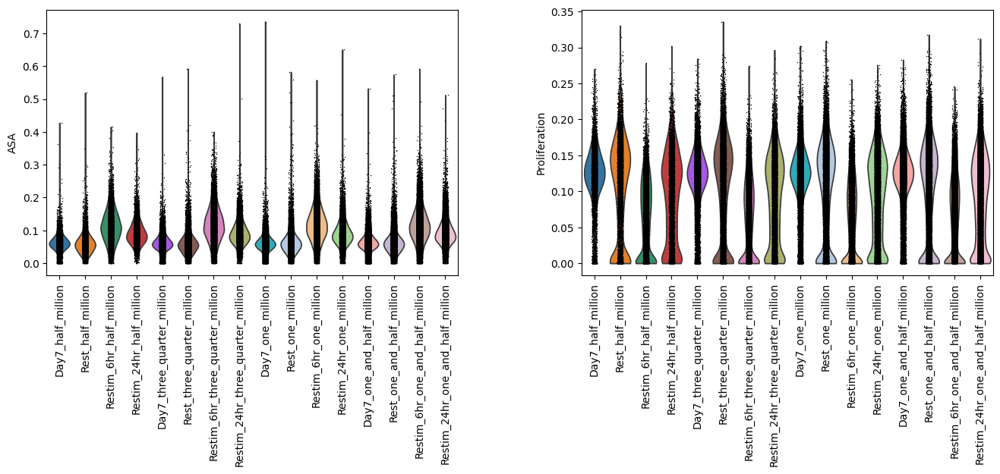

In [11]:
sc.pl.violin(adata, ['ASA', 'Proliferation'], groupby='sample_id', rotation=90)

In [ ]:
top_usage = pd.DataFrame(usage.idxmax(axis=1), columns=['top_usage'])
top_usage['sample_id'] = adata.obs['sample_id'].values

# Calculate confusion matrix between top_usage and Tcells_louvain_anno
conf_mat = sc.metrics.confusion_matrix('sample_id', 'top_usage',data=top_usage)

# Plot heatmap and get cluster order
g = sns.clustermap(conf_mat, cmap='YlOrRd', figsize=(15,10))
anno_order = conf_mat.index[g.dendrogram_row.reordered_ind].tolist()
plt.xticks(rotation=90)
plt.tight_layout()

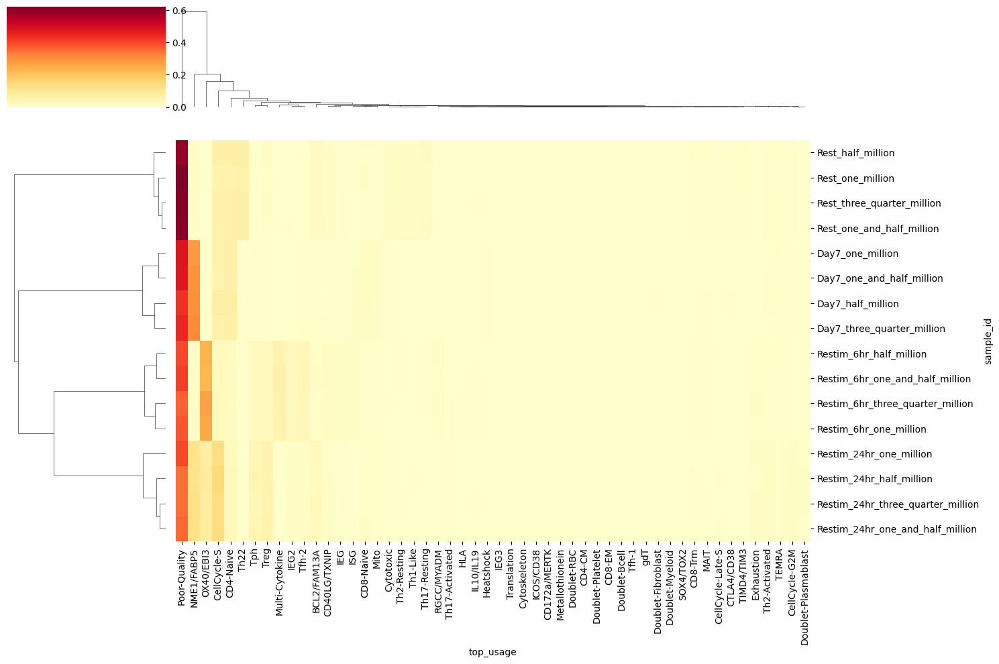

In [12]:
top_usage = pd.DataFrame(usage.idxmax(axis=1), columns=['top_usage'])
top_usage['sample_id'] = adata.obs['sample_id'].values

# Calculate confusion matrix between top_usage and Tcells_louvain_anno
conf_mat = sc.metrics.confusion_matrix('sample_id', 'top_usage',data=top_usage)

# Plot heatmap and get cluster order
g = sns.clustermap(conf_mat, cmap='YlOrRd', figsize=(15,10))
anno_order = conf_mat.index[g.dendrogram_row.reordered_ind].tolist()
plt.xticks(rotation=90)
plt.tight_layout()

In [51]:
for pr in usage.columns:
    q = np.quantile(usage[pr], 0.99)
    adata.obs[f'usage_{pr}'] = np.where(usage[pr] > q, q, usage[pr])
# sc.pl.umap(adata, color='usage_CD4-Naive', size=10)

In [65]:
missing_gs = np.setdiff1d(tcat.ref.columns, adata.var_names).tolist()

/home/users/emmadann/.local/lib/python3.12/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/home/users/emmadann/.local/lib/python3.12/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


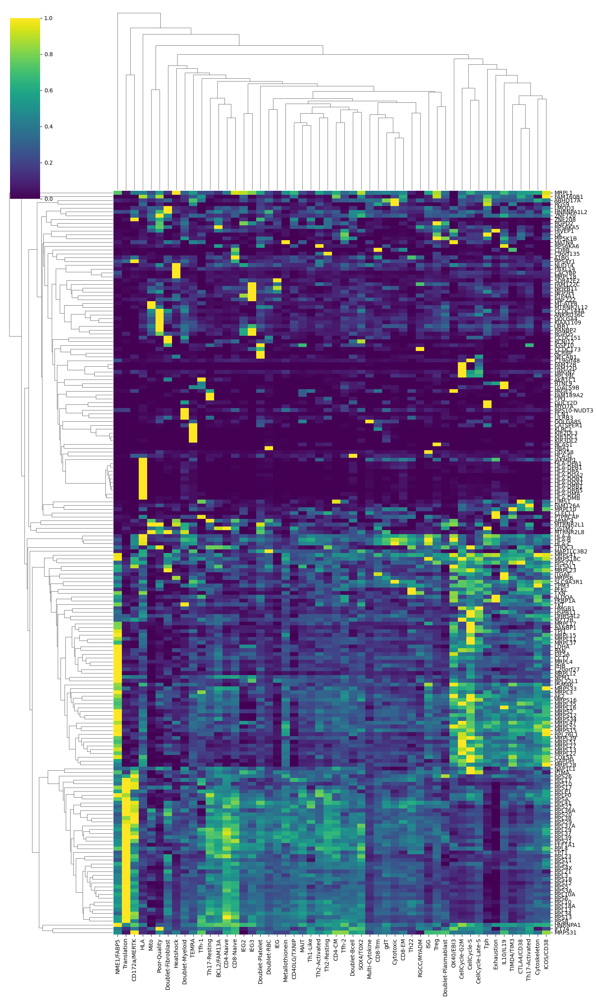

In [73]:
sns.clustermap(tcat.ref[missing_gs].T, standard_scale=0, cmap='viridis', figsize=(15,25), xticklabels=True, yticklabels=True)

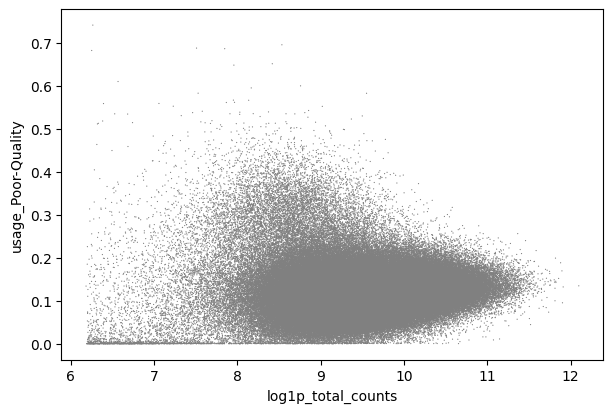

In [106]:
sc.pl.scatter(adata, '', 'usage_Poor-Quality', size=3)

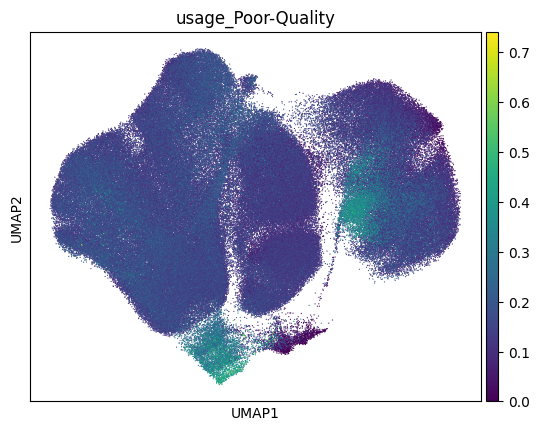

In [103]:
pr='Poor-Quality'
adata.obs[f'usage_{pr}'] = usage[pr]
sc.pl.umap(adata, color=['usage_Poor-Quality'], ncols=5, size=3)

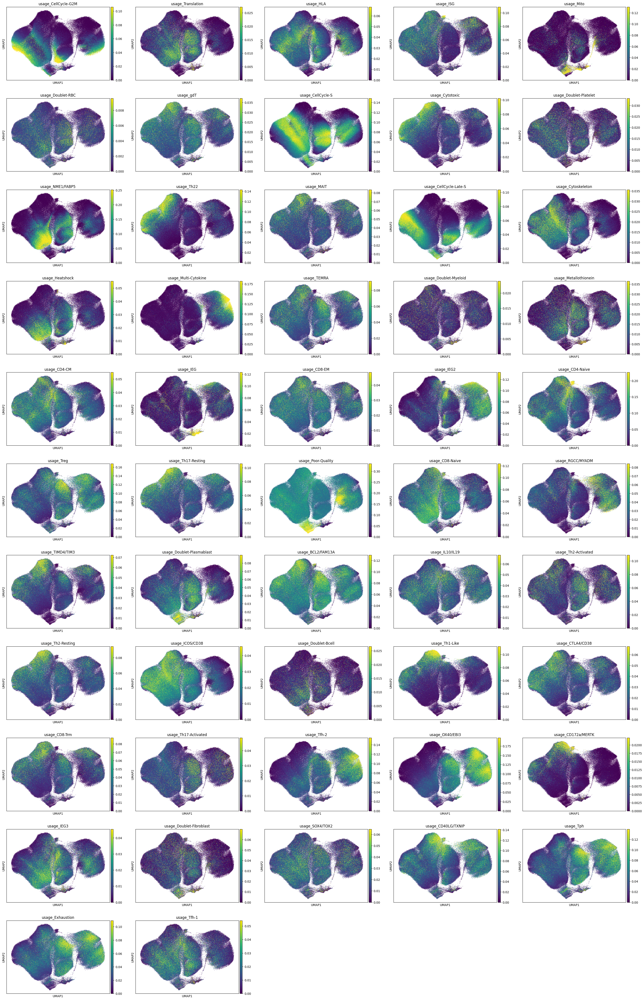

In [52]:
sc.pl.umap(adata, color=[f'usage_{x}' for x in usage.columns], ncols=5, size=3)

In [ ]:
tcat.ref['MALAT1']

In [101]:
tcat.ref['MALAT1'].sort_values(ascending=False)[0:30]

KeyError: 'MALAT1'

In [100]:
tcat.ref.loc['Exhaustion'].sort_values(ascending=False)[0:30]

LAG3        1319.071167
HAVCR2      1108.354370
TIMD4        883.503479
PTMS         811.480896
GZMB         643.149414
PRF1         639.890564
NKG7         617.549194
CST7         617.091064
GZMA         614.004883
CD27         611.111145
CD38         590.564270
CADM1        589.375610
SLC27A2      556.246643
CD200R1      537.968872
RAB38        537.871277
LYST         536.000854
PDCD1        519.485779
VCAM1        513.523071
B2M          492.403931
DUSP5        490.018829
NAB1         483.900665
HLA-A        474.799408
TSC22D1      459.868286
SEMA4A       447.338409
SNAP47       427.935364
FKBP1A       412.077942
RDH10        409.285583
TNIP3        399.566895
APOBEC3C     393.797668
APBB2        383.485443
Name: Exhaustion, dtype: float32

In [81]:
usage['sample_id'] = adata.obs['sample_id']

/tmp/ipykernel_122219/1505534452.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  sns.clustermap(usage.groupby('sample_id').mean())


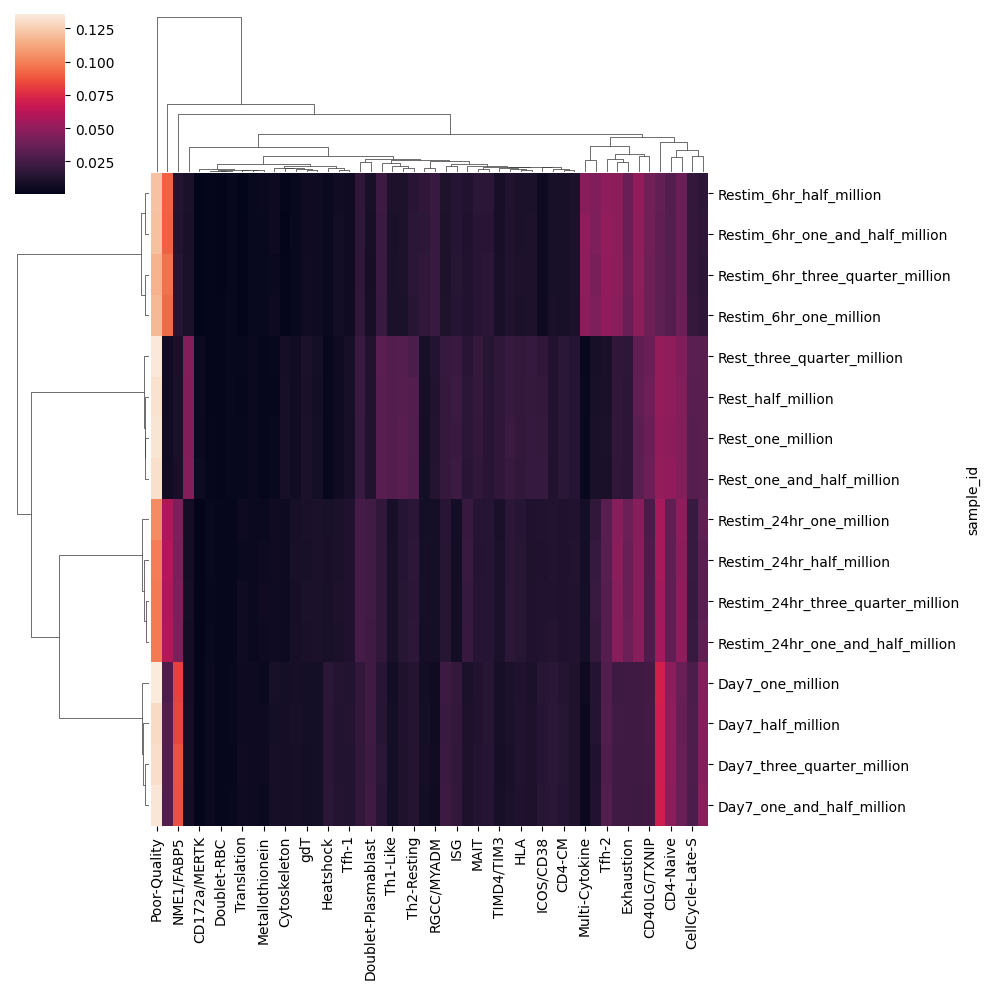

In [83]:
sns.clustermap(usage.groupby('sample_id').mean())

In [109]:
# add ../../src/ to path from which I can import packages
import sys
sys.path.append('../../src/')
import utils.cnmf_utils

In [114]:
sc.pp.normalize_total(adata)
sc.pp.log1p(adata)

In [125]:
utils.cnmf_utils.get_variance_explained(adata, usage.drop('sample_id', axis=1), tcat.ref.T, 
    use_genes=np.intersect1d(adata.var_names, tcat.ref.columns))

: 